In [1]:
%load_ext autoreload
%autoreload 2

In [2]:
import os
import sys
current_path = os.getcwd()
parent_directory = os.path.dirname(current_path)
sys.path.append(parent_directory)
from Class.jenie import Jenie
import pandas as pd
import numpy as np
import scanpy as sc
import anndata
import umap.umap_ as umap
import leidenalg
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
import seaborn as sns
from sklearn.cluster import KMeans
from scipy.spatial.distance import pdist, squareform
from sklearn.metrics import pairwise_distances
from scipy.stats import zscore
from matplotlib.colorbar import ColorbarBase
import matplotlib.colors as mcolors
from umap import UMAP
from sklearn.model_selection import GridSearchCV
from sklearn.metrics import silhouette_score
from kneed import KneeLocator
from sklearn.decomposition import PCA
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis
from sklearn.model_selection import ParameterGrid

In [3]:
plt.style.use('dark_background')

In [4]:
gellyfish_scdata = sc.read_h5ad(r"D:\SMI-0214_DonCleveland_UCSD\SMI-0214_DonCleveland_UCSD\gellyfish_scdata.h5ad")
gellyfish_scdata

C:\Users\krist\AppData\Local\Programs\Python\Python311\Lib\site-packages\anndata\_core\anndata.py:1830: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


AnnData object with n_obs × n_vars = 209977 × 223
    obs: 'n_genes', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'leiden', 'Experiment', 'Age', 'Mouse', 'Section', 'Treatment', 'MERFISH celltype', 'celltype', 'x'
    uns: 'celltype_colors', 'leiden', 'leiden_colors', 'neighbors', 'x_colors'
    obsm: 'X_pca', 'X_spatial', 'X_umap'
    obsp: 'connectivities', 'distances'

### Gellyfish - Plot umap

In [5]:
adata_gellyfish = Jenie(gellyfish_scdata, 'gellyfish_scdata', 'gellyfish_scdata', pallete = 'gellyfish_celltype')

C:\Users\krist\AppData\Local\Programs\Python\Python311\Lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
C:\Users\krist\AppData\Local\Programs\Python\Python311\Lib\site-packages\scanpy\plotting\_tools\scatterplots.py:371: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(
C:\Users\krist\AppData\Local\Programs\Python\Python311\Lib\site-packages\scanpy\plotting\_tools\scatterplots.py:381: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(
C:\Users\krist\AppData\Local\Programs\Python\Python311\Lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


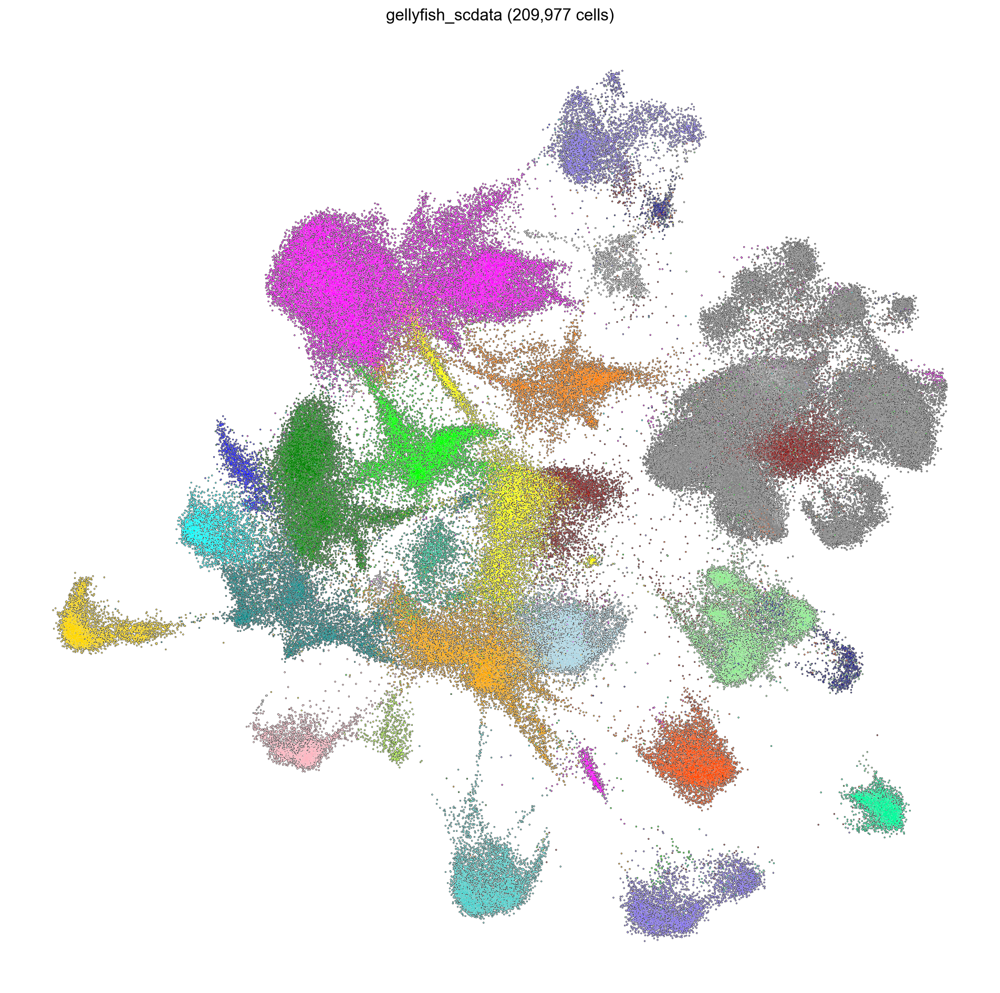

In [6]:
adata_gellyfish.umap(group = 'celltype', size = 3)

C:\Users\krist\AppData\Local\Programs\Python\Python311\Lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


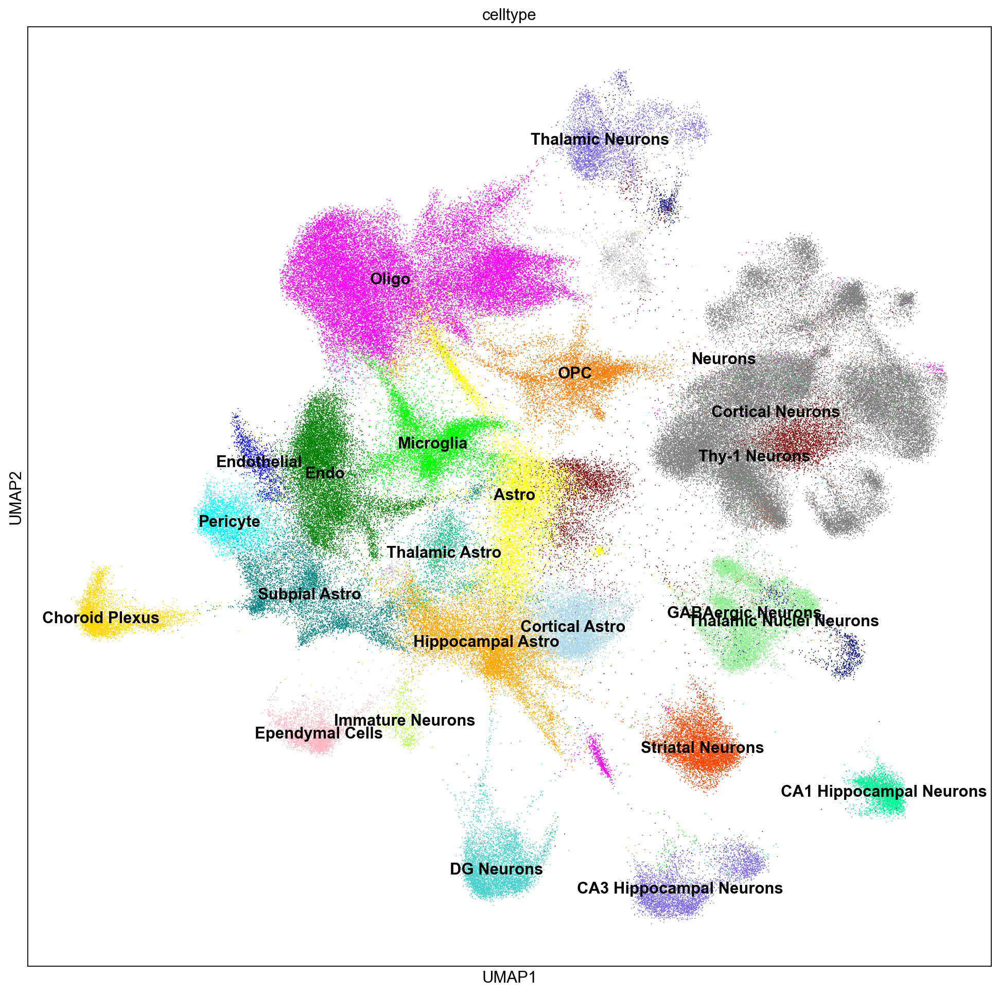

In [7]:
sc.pl.umap(gellyfish_scdata, color = 'celltype', legend_loc = 'on data', size = 3)

### Plot Brain Proj

In [8]:
gellyfish_scdata

AnnData object with n_obs × n_vars = 209977 × 223
    obs: 'n_genes', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'leiden', 'Experiment', 'Age', 'Mouse', 'Section', 'Treatment', 'MERFISH celltype', 'celltype', 'x'
    uns: 'celltype_colors', 'leiden', 'leiden_colors', 'neighbors', 'x_colors'
    obsm: 'X_pca', 'X_spatial', 'X_umap'
    obsp: 'connectivities', 'distances'

C:\Users\krist\AppData\Local\Programs\Python\Python311\Lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


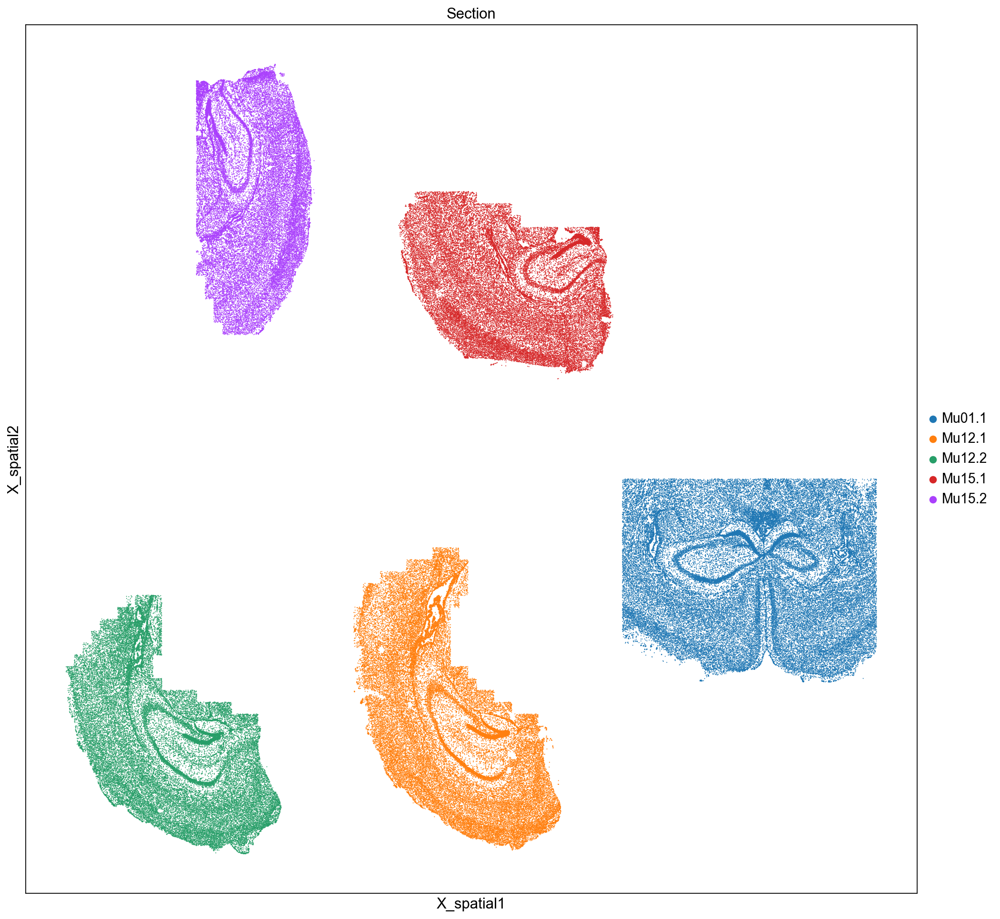

In [10]:
sc.pl.embedding(gellyfish_scdata, basis = 'X_spatial', color = 'Section', size = 3)

In [12]:
gellyfish_Mu01_1_scdata = gellyfish_scdata[gellyfish_scdata.obs['Section'] == 'Mu01.1']
gellyfish_Mu01_1_scdata

View of AnnData object with n_obs × n_vars = 57489 × 223
    obs: 'n_genes', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'leiden', 'Experiment', 'Age', 'Mouse', 'Section', 'Treatment', 'MERFISH celltype', 'celltype', 'x'
    uns: 'celltype_colors', 'leiden', 'leiden_colors', 'neighbors', 'x_colors', 'Section_colors'
    obsm: 'X_pca', 'X_spatial', 'X_umap'
    obsp: 'connectivities', 'distances'

In [13]:
gellyfish_Mu12_2_scdata = gellyfish_scdata[gellyfish_scdata.obs['Section'] == 'Mu12.2']
gellyfish_Mu12_2_scdata

View of AnnData object with n_obs × n_vars = 39624 × 223
    obs: 'n_genes', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'leiden', 'Experiment', 'Age', 'Mouse', 'Section', 'Treatment', 'MERFISH celltype', 'celltype', 'x'
    uns: 'celltype_colors', 'leiden', 'leiden_colors', 'neighbors', 'x_colors', 'Section_colors'
    obsm: 'X_pca', 'X_spatial', 'X_umap'
    obsp: 'connectivities', 'distances'

In [15]:
adata_gellyfish_Mu01_1 = Jenie(gellyfish_Mu01_1_scdata, 'gellyfish_Mu01_1_scdata', 'gellyfish_Mu01_1_scdata', pallete = 'gellyfish_celltype')

In [16]:
adata_gellyfish_Mu12_2 = Jenie(gellyfish_Mu12_2_scdata, 'gellyfish_Mu12_2_scdata', 'gellyfish_Mu12_2_scdata', pallete = 'gellyfish_celltype')

### Brain Proj for Mu01.1

C:\Users\krist\AppData\Local\Programs\Python\Python311\Lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


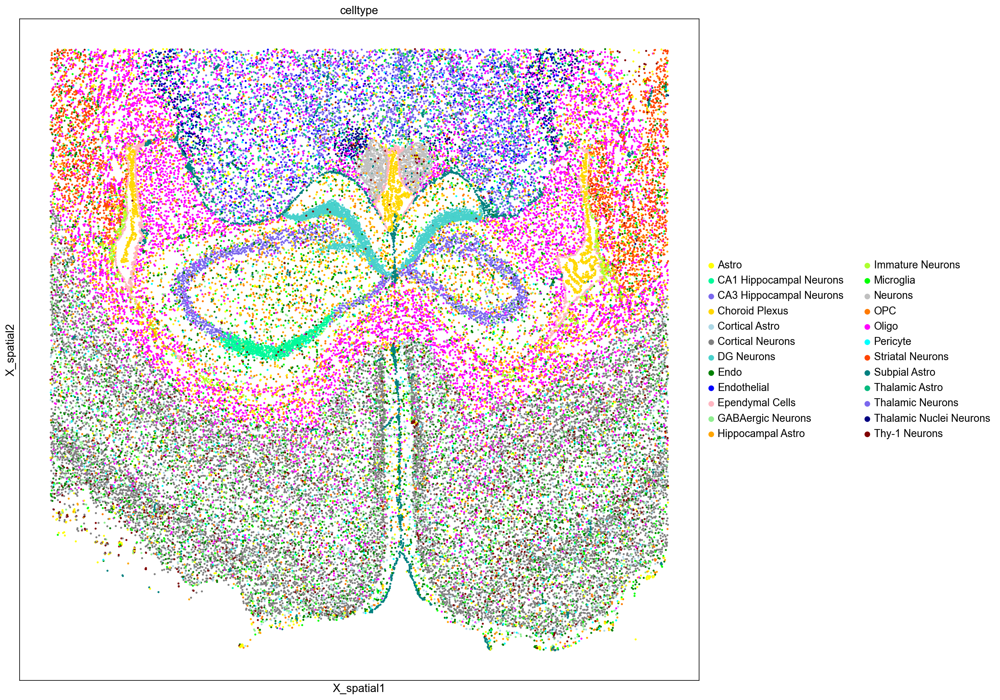

In [20]:
sc.pl.embedding(gellyfish_Mu01_1_scdata, basis = 'X_spatial', color = 'celltype', size = 25)

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


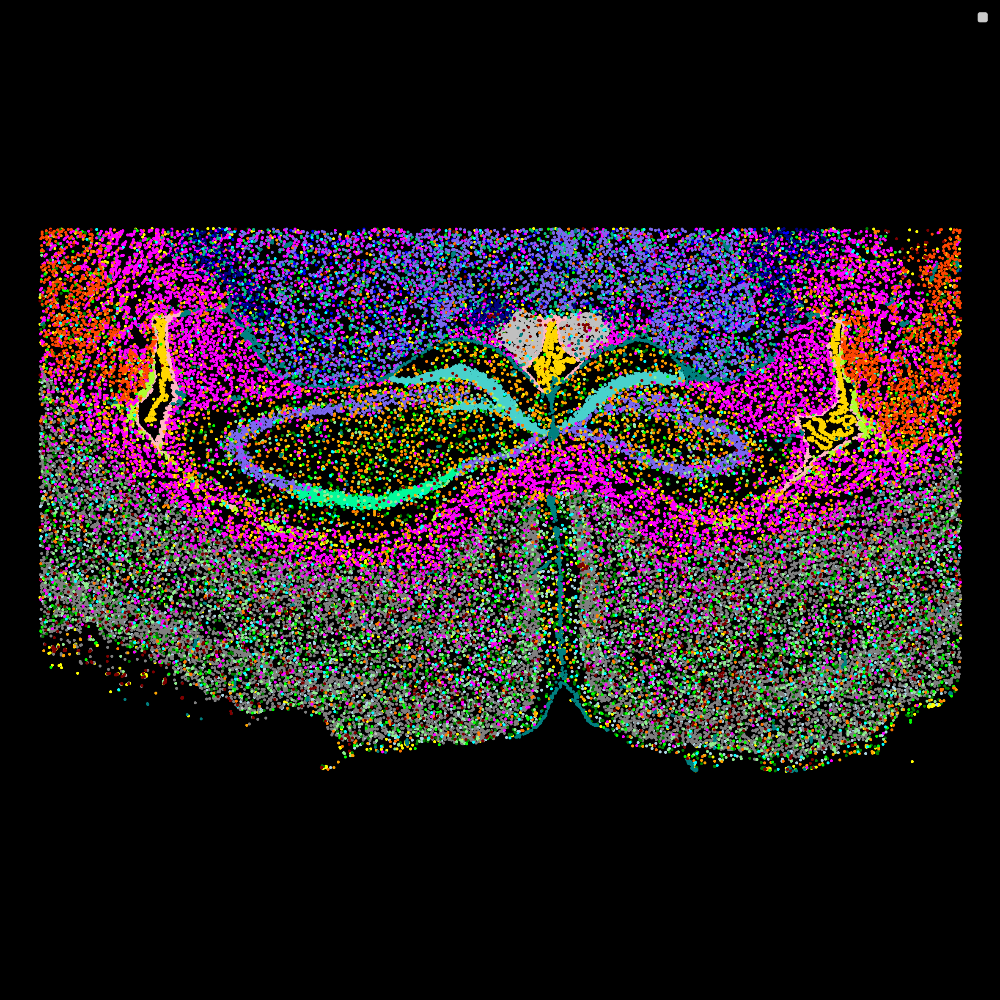

In [22]:
adata_gellyfish_Mu01_1.plot_cluster_scdata(group = 'celltype', sbig = 20)

### Brain Proj for Mu12.2

C:\Users\krist\AppData\Local\Programs\Python\Python311\Lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


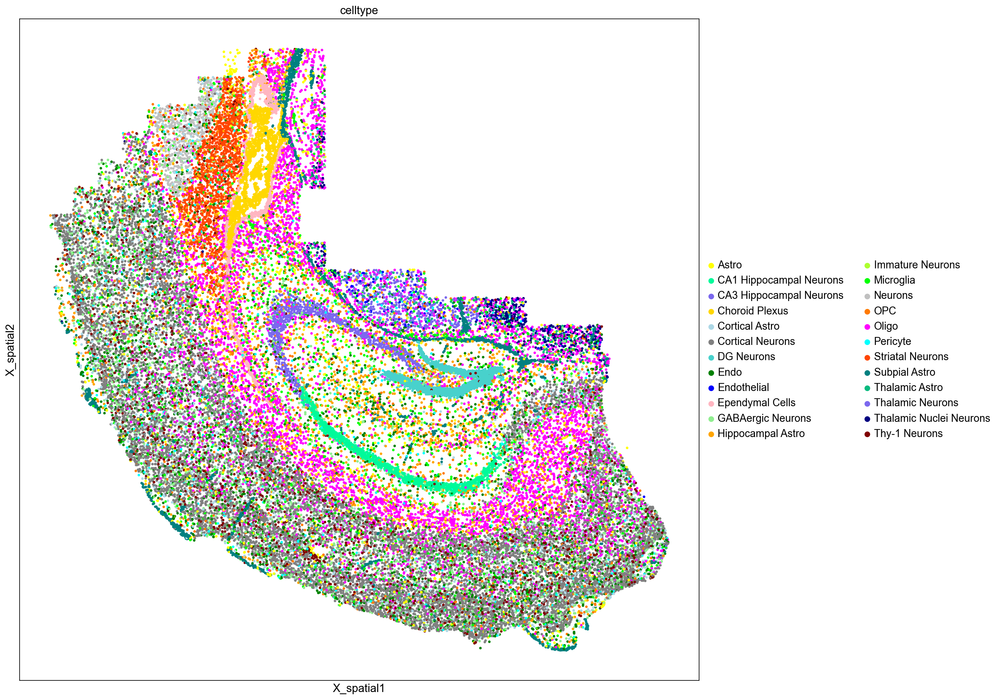

In [26]:
sc.pl.embedding(gellyfish_Mu12_2_scdata, basis = 'X_spatial', color = 'celltype', size = 40)

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


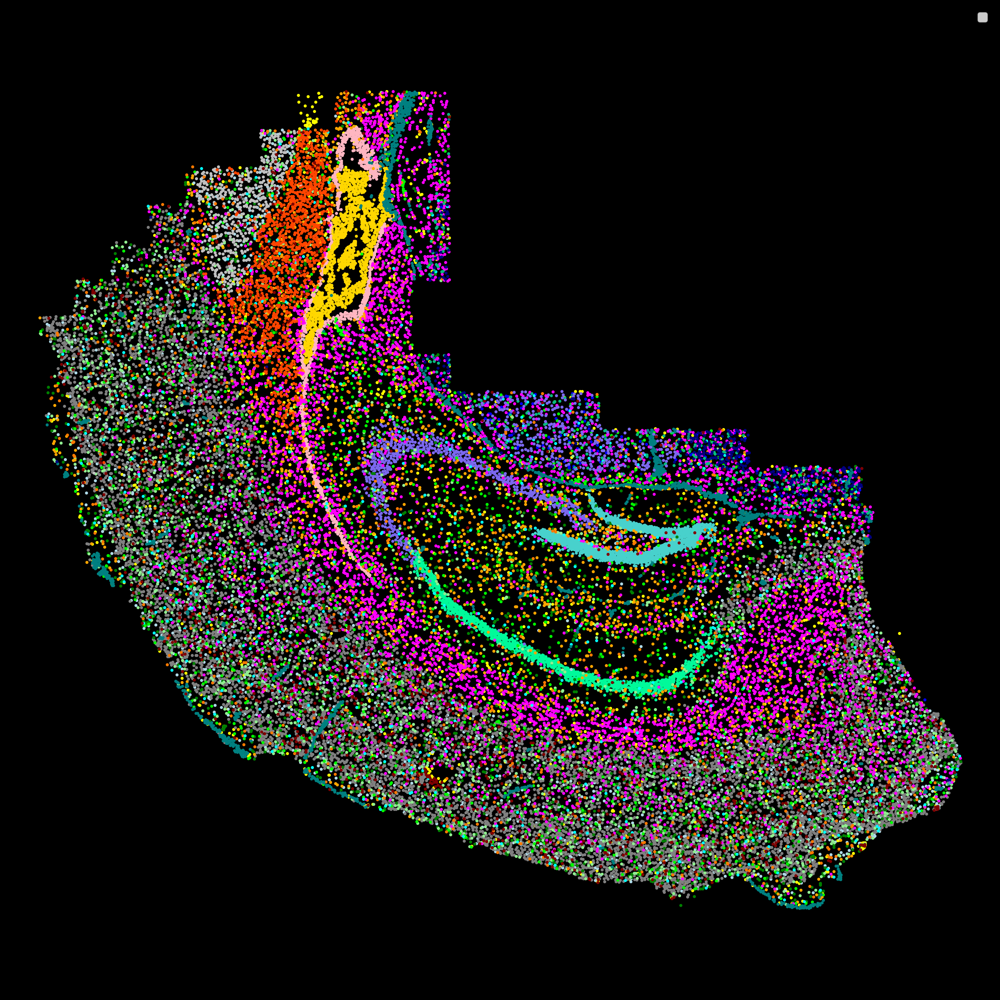

In [27]:
adata_gellyfish_Mu12_2.plot_cluster_scdata(group = 'celltype', sbig = 20)